In [1]:
import pandas as pd # dataframe manipulation
import numpy as np # linear algebra

# data visualization
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns
import shap

# sklearn 
from sklearn.cluster import KMeans
from sklearn.preprocessing import PowerTransformer, OrdinalEncoder
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.metrics import silhouette_score, silhouette_samples, accuracy_score, classification_report

from pyod.models.ecod import ECOD
from yellowbrick.cluster import KElbowVisualizer

import lightgbm as lgb
import prince



IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html


In [2]:
rfm = pd.read_csv('./data/rfm_olist_final.csv')
rfm

,customer_unique_id,recency,frequency,monetary
0,0000366f3b9a7992bf8c76cfdf3221e2,111,1,141.90
1,0000b849f77a49e4a4ce2b2a4ca5be3f,114,1,27.19
2,0000f46a3911fa3c0805444483337064,536,1,86.22
3,0000f6ccb0745a6a4b88665a16c9f078,320,1,43.62
4,0004aac84e0df4da2b147fca70cf8255,287,1,196.89
...,...,...,...,...
93352,fffcf5a5ff07b0908bd4e2dbc735a684,446,2,4134.84
93353,fffea47cd6d3cc0a88bd621562a9d061,261,1,84.58
93354,ffff371b4d645b6ecea244b27531430a,567,1,112.46
93355,ffff5962728ec6157033ef9805bacc48,118,1,133.69


In [3]:
rfm.describe()

,recency,frequency,monetary
count,93357.000000,93357.000000,93357.000000
mean,236.936673,1.232205,211.833718
std,152.584315,0.819763,642.166523
min,0.000000,1.000000,9.590000
25%,113.000000,1.000000,63.760000
50%,218.000000,1.000000,112.950000
75%,345.000000,1.000000,201.740000
max,694.000000,75.000000,109312.640000


In [4]:
import pandas as pd  # dataframe manipulation
import numpy as np  # linear algebra
from sentence_transformers import SentenceTransformer
from dice_embeddings import DICE

dice = DICE(d = 20, min_bound=0, max_bound=150000, norm="l2")

def get_numeric_embedding(x):
    
    embeddings = []
    
    for val in x:
        out = dice.make_dice(val)   
        embeddings.append(list(out))

    # make flat list
    embeddings = [item for sublist in embeddings for item in sublist]
    return embeddings


# model = SentenceTransformer(r"sentence-transformers/all-roberta-large-v1")

out = pd.DataFrame()

for index, row in rfm.iterrows():
    # sentence = compile_text(row)
    # sentence_embedding = pd.DataFrame(model.encode(sentences=sentence, show_progress_bar=False, normalize_embeddings=True)).T
    numeric_embedding = pd.DataFrame(get_numeric_embedding([row['recency'], row['frequency'], row['monetary']])).T

    customer_unique_id = pd.DataFrame([row['customer_unique_id']])
    
    complete_embedding_df = pd.concat([customer_unique_id, numeric_embedding], axis=1)
    
    out = pd.concat([out, complete_embedding_df], axis=0)
    
    # # write to csv after every 1000 rows
    # if index % 1000 == 0:
    #     out.to_csv('output/olist_rfm_numeric_embeddings-2.csv', index=False)
    
    print(f"Finished row {index}")
    
    # sentences.append(compile_text(row))

# model = SentenceTransformer(r"sentence-transformers/all-roberta-large-v1")

# output = model.encode(sentences=sentences, show_progress_bar=True, normalize_embeddings=True)
original_embedding = out.copy()
out

Finished row 0
Finished row 1
Finished row 2
Finished row 3
Finished row 4
Finished row 5
Finished row 6
Finished row 7
Finished row 8
Finished row 9
Finished row 10
Finished row 11
Finished row 12
Finished row 13
Finished row 14
Finished row 15
Finished row 16
Finished row 17
Finished row 18
Finished row 19
Finished row 20
Finished row 21
Finished row 22
Finished row 23
Finished row 24
Finished row 25
Finished row 26
Finished row 27
Finished row 28
Finished row 29
Finished row 30
Finished row 31
Finished row 32
Finished row 33
Finished row 34
Finished row 35
Finished row 36
Finished row 37
Finished row 38
Finished row 39
Finished row 40
Finished row 41
Finished row 42
Finished row 43
Finished row 44
Finished row 45
Finished row 46
Finished row 47
Finished row 48
Finished row 49
Finished row 50
Finished row 51
Finished row 52
Finished row 53
Finished row 54
Finished row 55
Finished row 56
Finished row 57
Finished row 58
Finished row 59
Finished row 60
Finished row 61
Finished row 62
Fi

,0,0,1,2,3,4,5,6,7,8,...,50,51,52,53,54,55,56,57,58,59
0,0000366f3b9a7992bf8c76cfdf3221e2,-0.160531,-0.105530,-0.074302,0.134845,0.050280,0.409743,0.212733,-0.248290,0.101531,...,0.273142,-0.192014,-0.127352,0.194667,-0.373330,-0.344990,0.029560,-0.381328,-0.151916,-0.236219
0,0000b849f77a49e4a4ce2b2a4ca5be3f,-0.160515,-0.105532,-0.074300,0.134834,0.050304,0.409757,0.212750,-0.248282,0.101562,...,0.273566,-0.191876,-0.127862,0.195098,-0.373436,-0.344655,0.030562,-0.381655,-0.151751,-0.236113
0,0000f46a3911fa3c0805444483337064,-0.158257,-0.105785,-0.074062,0.133304,0.053792,0.411685,0.215105,-0.247200,0.105834,...,0.273348,-0.191947,-0.127599,0.194877,-0.373382,-0.344827,0.030046,-0.381488,-0.151837,-0.236168
0,0000f6ccb0745a6a4b88665a16c9f078,-0.159420,-0.105660,-0.074180,0.134087,0.052002,0.410701,0.213909,-0.247751,0.103643,...,0.273506,-0.191896,-0.127789,0.195037,-0.373421,-0.344703,0.030419,-0.381609,-0.151775,-0.236128
0,0004aac84e0df4da2b147fca70cf8255,-0.159596,-0.105640,-0.074199,0.134206,0.051730,0.410550,0.213724,-0.247836,0.103309,...,0.272940,-0.192080,-0.127107,0.194459,-0.373278,-0.345152,0.029081,-0.381169,-0.151995,-0.236269
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,fffcf5a5ff07b0908bd4e2dbc735a684,-0.158743,-0.105734,-0.074110,0.133630,0.053045,0.411276,0.214609,-0.247429,0.104920,...,0.259663,-0.196358,-0.109881,0.177801,-0.367748,-0.357452,-0.002581,-0.366099,-0.156606,-0.238272
0,fffea47cd6d3cc0a88bd621562a9d061,-0.159735,-0.105624,-0.074214,0.134301,0.051515,0.410431,0.213579,-0.247903,0.103046,...,0.273354,-0.191945,-0.127607,0.194883,-0.373383,-0.344822,0.030060,-0.381492,-0.151834,-0.236166
0,ffff371b4d645b6ecea244b27531430a,-0.158089,-0.105802,-0.074045,0.133191,0.054050,0.411825,0.215276,-0.247121,0.106148,...,0.273251,-0.191979,-0.127483,0.194778,-0.373357,-0.344904,0.029817,-0.381412,-0.151874,-0.236192
0,ffff5962728ec6157033ef9805bacc48,-0.160494,-0.105535,-0.074298,0.134820,0.050337,0.409775,0.212773,-0.248272,0.101602,...,0.273173,-0.192004,-0.127388,0.194698,-0.373338,-0.344966,0.029631,-0.381351,-0.151905,-0.236211


In [5]:
embeddings = out
embeddings.describe()

,0,1,2,3,4,5,6,7,8,9,...,50,51,52,53,54,55,56,57,58,59
count,93357.000000,93357.000000,93357.000000,93357.000000,93357.000000,93357.000000,93357.000000,93357.000000,93357.000000,93357.000000,...,93357.000000,93357.000000,93357.000000,93357.000000,93357.000000,93357.000000,93357.000000,93357.000000,93357.000000,93357.000000
mean,-0.159859,-0.105607,-0.074230,0.134388,0.051319,0.410319,0.213439,-0.247966,0.102805,0.049114,...,0.272906,-0.192088,-0.127047,0.194385,-0.373231,-0.345182,0.029019,-0.381071,-0.151995,-0.236245
std,0.000814,0.000093,0.000088,0.000554,0.001259,0.000698,0.000855,0.000392,0.001543,0.000705,...,0.002206,0.001637,0.002431,0.002367,0.002355,0.002460,0.003348,0.003210,0.001152,0.001599
min,-0.161116,-0.105871,-0.074370,0.132731,0.049368,0.409232,0.212101,-0.248578,0.100413,0.047013,...,-0.246203,-0.266331,-0.127941,-0.073317,-0.373452,-0.394513,-0.116777,-0.381705,-0.166772,-0.238281
25%,-0.160520,-0.105674,-0.074301,0.133996,0.050296,0.409752,0.212744,-0.248285,0.101551,0.048614,...,0.272922,-0.192085,-0.127699,0.194440,-0.373403,-0.345166,0.029038,-0.381552,-0.152002,-0.236273
50%,-0.159964,-0.105598,-0.074239,0.134457,0.051161,0.410234,0.213337,-0.248014,0.102612,0.049200,...,0.273249,-0.191979,-0.127481,0.194776,-0.373357,-0.344905,0.029812,-0.381411,-0.151875,-0.236192
75%,-0.159286,-0.105532,-0.074166,0.134838,0.052209,0.410815,0.214048,-0.247687,0.103896,0.049686,...,0.273431,-0.191920,-0.127086,0.194961,-0.373273,-0.344761,0.030243,-0.381154,-0.151804,-0.236147
max,-0.157398,-0.105459,-0.073980,0.135248,0.055107,0.412400,0.215969,-0.246800,0.107440,0.050212,...,0.273632,0.259396,0.076745,0.195164,0.237985,0.244333,0.159080,0.125294,0.169379,0.059488


In [6]:
def get_pca_2d(df, predict):
    pca_2d_object = prince.PCA(
    n_components=2,
    n_iter=3,
    rescale_with_mean=True,
    rescale_with_std=True,
    copy=True,
    check_input=True,
    engine='sklearn',
    random_state=42
    )

    pca_2d_object.fit(df)

    df_pca_2d = pca_2d_object.transform(df)
    df_pca_2d.columns = ["comp1", "comp2"]
    df_pca_2d["cluster"] = predict

    return pca_2d_object, df_pca_2d



def get_pca_3d(df, predict):
    pca_3d_object = prince.PCA(
        n_components=3,
        n_iter=3,
        rescale_with_mean=True,
        rescale_with_std=True,
        copy=True,
        check_input=True,
        engine='sklearn',
        random_state=42
    )

    pca_3d_object.fit(df)

    df_pca_3d = pca_3d_object.transform(df)
    df_pca_3d.columns = ["comp1", "comp2", "comp3"]
    df_pca_3d["cluster"] = predict

    return pca_3d_object, df_pca_3d



def plot_pca_3d(df, title = "PCA Space", opacity=0.8, width_line = 0.1):

    df = df.astype({"cluster": "object"})
    df = df.sort_values("cluster")

    fig = px.scatter_3d(df, 
                        x='comp1', 
                        y='comp2', 
                        z='comp3',
                        color='cluster',
                        template="plotly",
                        
                        # symbol = "cluster",
                        
                        color_discrete_sequence=px.colors.qualitative.Vivid,
                        title=title).update_traces(
                            # mode = 'markers',
                            marker={
                                "size": 4,
                                "opacity": opacity,
                                # "symbol" : "diamond",
                                "line": {
                                    "width": width_line,
                                    "color": "black",
                                }
                            }
                        ).update_layout(
                                width = 1000, 
                                height = 800, 
                                autosize = False, 
                                showlegend = True,
                                legend=dict(title_font_family="Times New Roman",
                                            font=dict(size= 20)),
                                scene = dict(xaxis=dict(title = 'comp1', titlefont_color = 'black'),
                                            yaxis=dict(title = 'comp2', titlefont_color = 'black'),
                                            zaxis=dict(title = 'comp3', titlefont_color = 'black')),
                                font = dict(family = "Gilroy", color  = 'black', size = 15))
                      
    
    fig.show()


def plot_pca_2d(df, title = "PCA Space", opacity=0.8, width_line = 0.1):

    df = df.astype({"cluster": "object"})
    df = df.sort_values("cluster")

    fig = px.scatter(df, 
                        x='comp1', 
                        y='comp2', 
                        color='cluster',
                        template="plotly",
                        # symbol = "cluster",
                        
                        color_discrete_sequence=px.colors.qualitative.Vivid,
                        title=title).update_traces(
                            # mode = 'markers',
                            marker={
                                "size": 8,
                                "opacity": opacity,
                                # "symbol" : "diamond",
                                "line": {
                                    "width": width_line,
                                    "color": "black",
                                }
                            }
                        ).update_layout(
                                width = 800, 
                                height = 700, 
                                autosize = False, 
                                showlegend = True,
                                legend=dict(title_font_family="Times New Roman",
                                            font=dict(size= 20)),
                                scene = dict(xaxis=dict(title = 'comp1', titlefont_color = 'black'),
                                            yaxis=dict(title = 'comp2', titlefont_color = 'black'),
                                            ),
                                font = dict(family = "Gilroy", color  = 'black', size = 15))
                        
        
    fig.show()


In [7]:
############################################################################################################

In [8]:
# # normalize data
# from sklearn.preprocessing import StandardScaler
# scaler = StandardScaler()
# rfm_scaled = scaler.fit_transform(rfm.iloc[:,1:])
# rfm_scaled = pd.DataFrame(rfm_scaled, columns=rfm.columns[1:])
# rfm_scaled['customer_unique_id'] = rfm['customer_unique_id']

# # make customer_unique_id the first column
# cols = list(rfm_scaled.columns)
# cols = [cols[-1]] + cols[:-1]
# rfm_scaled = rfm_scaled[cols]


In [9]:
embeddings.iloc[:,]

,0,0,1,2,3,4,5,6,7,8,...,50,51,52,53,54,55,56,57,58,59
0,0000366f3b9a7992bf8c76cfdf3221e2,-0.160531,-0.105530,-0.074302,0.134845,0.050280,0.409743,0.212733,-0.248290,0.101531,...,0.273142,-0.192014,-0.127352,0.194667,-0.373330,-0.344990,0.029560,-0.381328,-0.151916,-0.236219
0,0000b849f77a49e4a4ce2b2a4ca5be3f,-0.160515,-0.105532,-0.074300,0.134834,0.050304,0.409757,0.212750,-0.248282,0.101562,...,0.273566,-0.191876,-0.127862,0.195098,-0.373436,-0.344655,0.030562,-0.381655,-0.151751,-0.236113
0,0000f46a3911fa3c0805444483337064,-0.158257,-0.105785,-0.074062,0.133304,0.053792,0.411685,0.215105,-0.247200,0.105834,...,0.273348,-0.191947,-0.127599,0.194877,-0.373382,-0.344827,0.030046,-0.381488,-0.151837,-0.236168
0,0000f6ccb0745a6a4b88665a16c9f078,-0.159420,-0.105660,-0.074180,0.134087,0.052002,0.410701,0.213909,-0.247751,0.103643,...,0.273506,-0.191896,-0.127789,0.195037,-0.373421,-0.344703,0.030419,-0.381609,-0.151775,-0.236128
0,0004aac84e0df4da2b147fca70cf8255,-0.159596,-0.105640,-0.074199,0.134206,0.051730,0.410550,0.213724,-0.247836,0.103309,...,0.272940,-0.192080,-0.127107,0.194459,-0.373278,-0.345152,0.029081,-0.381169,-0.151995,-0.236269
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,fffcf5a5ff07b0908bd4e2dbc735a684,-0.158743,-0.105734,-0.074110,0.133630,0.053045,0.411276,0.214609,-0.247429,0.104920,...,0.259663,-0.196358,-0.109881,0.177801,-0.367748,-0.357452,-0.002581,-0.366099,-0.156606,-0.238272
0,fffea47cd6d3cc0a88bd621562a9d061,-0.159735,-0.105624,-0.074214,0.134301,0.051515,0.410431,0.213579,-0.247903,0.103046,...,0.273354,-0.191945,-0.127607,0.194883,-0.373383,-0.344822,0.030060,-0.381492,-0.151834,-0.236166
0,ffff371b4d645b6ecea244b27531430a,-0.158089,-0.105802,-0.074045,0.133191,0.054050,0.411825,0.215276,-0.247121,0.106148,...,0.273251,-0.191979,-0.127483,0.194778,-0.373357,-0.344904,0.029817,-0.381412,-0.151874,-0.236192
0,ffff5962728ec6157033ef9805bacc48,-0.160494,-0.105535,-0.074298,0.134820,0.050337,0.409775,0.212773,-0.248272,0.101602,...,0.273173,-0.192004,-0.127388,0.194698,-0.373338,-0.344966,0.029631,-0.381351,-0.151905,-0.236211


In [10]:
from pyod.models.ecod import ECOD
# https://github.com/yzhao062/pyod

# Unsupervised Outlier Detection Using Empirical Cumulative Distribution Functions (ECOD)
clf = ECOD()
clf.fit(embeddings.iloc[:, 1:])

out = clf.predict(embeddings.iloc[:, 1:]) 
embeddings["outliers"] = out
rfm["outliers"] = out

rfm_no_out = rfm[rfm["outliers"] == 0]
rfm_no_out = rfm_no_out.drop(["outliers"], axis = 1)

embeddings_no_out = embeddings[embeddings["outliers"] == 0]
embeddings = embeddings_no_out.drop(["outliers"], axis = 1)

# df_embedding_with_out = embedding_df.copy()
# df_embedding_with_out = df_embedding_with_out.drop(["outliers"], axis = 1)

In [11]:
embeddings = embeddings_no_out

In [12]:
embeddings = embeddings_no_out.drop(["outliers"], axis = 1)


In [13]:
rfm = rfm_no_out

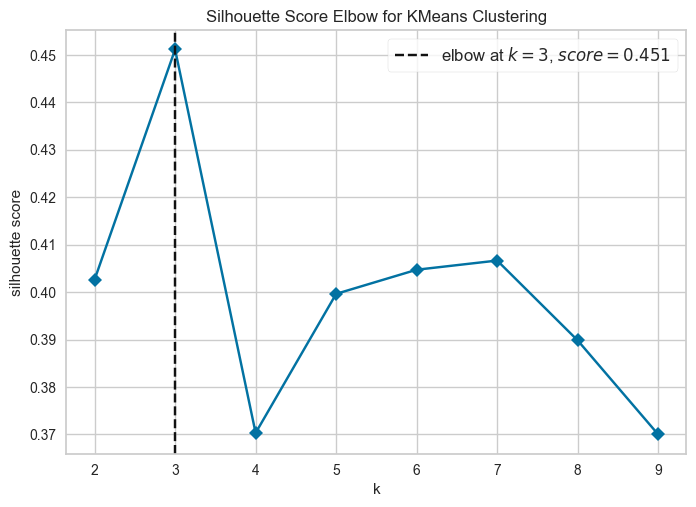

<Axes: title={'center': 'Silhouette Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='silhouette score'>

In [14]:
# Instantiate the clustering model and visualizer
km = KMeans(init="k-means++", random_state=0, n_init="auto")
visualizer = KElbowVisualizer(km, k=(2,10), locate_elbow=True, metric="silhouette", timings=False)

visualizer.fit(embeddings.iloc[:, 1:])        # Fit the data to the visualizer
visualizer.show()

In [15]:
km = KMeans(n_clusters=4, init='k-means++', n_init=10, max_iter=100, random_state=42)
clusters_predict = km.fit_predict(embeddings.iloc[:, 1:])
print(km.inertia_)

0.4756235708026802


In [16]:
from sklearn.metrics import silhouette_score
from sklearn.metrics import calinski_harabasz_score
from sklearn.metrics import davies_bouldin_score

"""
The Davies Bouldin index is defined as the average similarity measure of each cluster with its most similar cluster, where similarity is the ratio of within-cluster distances to between-cluster distances.
The minimum value of the DB Index is 0, whereas a smaller value (closer to 0) represents a better model that produces better clusters.
"""
print(f"Davies bouldin score: {davies_bouldin_score(embeddings.iloc[:, 1:],clusters_predict)}")

"""
Calinski Harabaz Index -> Variance Ratio Criterion.
Calinski Harabaz Index is defined as the ratio of the sum of between-cluster dispersion and of within-cluster dispersion.
The higher the index the more separable the clusters.
"""
print(f"Calinski Score: {calinski_harabasz_score(embeddings.iloc[:, 1:],clusters_predict)}")


"""
The silhouette score is a metric used to calculate the goodness of fit of a clustering algorithm, but can also be used as a method for determining an optimal value of k (see here for more).
Its value ranges from -1 to 1.
A value of 0 indicates clusters are overlapping and either the data or the value of k is incorrect.
1 is the ideal value and indicates that clusters are very dense and nicely separated.
"""
print(f"Silhouette Score: {silhouette_score(embeddings.iloc[:, 1:],clusters_predict)}")

Davies bouldin score: 0.7584360357777431
Calinski Score: 70764.42737939772
Silhouette Score: 0.4580554067327887


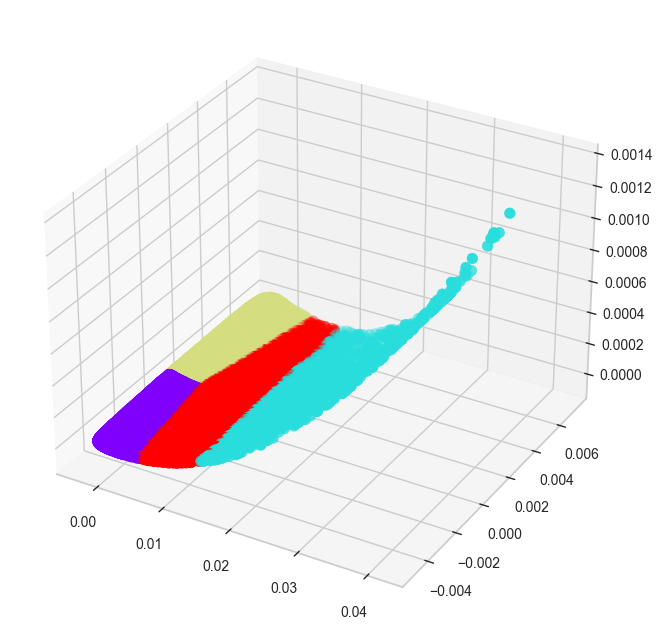

In [17]:
from sklearn.decomposition import PCA


pca = PCA(n_components=3)
pca.fit(embeddings.iloc[:, 1:])
pca_samples = pca.transform(embeddings.iloc[:, 1:])
ps = pd.DataFrame(pca_samples)
ps.columns = ['comp1', 'comp2', 'comp3']
ps['cluster'] = clusters_predict

fig = plt.figure(figsize=(8,8))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(ps['comp1'], ps['comp2'], ps['comp3'], c=ps['cluster'], cmap='rainbow', s=60)

In [18]:
embeddings.iloc[:, 1:]

,0,1,2,3,4,5,6,7,8,9,...,50,51,52,53,54,55,56,57,58,59
0,-0.160531,-0.105530,-0.074302,0.134845,0.050280,0.409743,0.212733,-0.248290,0.101531,0.049696,...,0.273142,-0.192014,-0.127352,0.194667,-0.373330,-0.344990,0.029560,-0.381328,-0.151916,-0.236219
0,-0.160515,-0.105532,-0.074300,0.134834,0.050304,0.409757,0.212750,-0.248282,0.101562,0.049682,...,0.273566,-0.191876,-0.127862,0.195098,-0.373436,-0.344655,0.030562,-0.381655,-0.151751,-0.236113
0,-0.158257,-0.105785,-0.074062,0.133304,0.053792,0.411685,0.215105,-0.247200,0.105834,0.047736,...,0.273348,-0.191947,-0.127599,0.194877,-0.373382,-0.344827,0.030046,-0.381488,-0.151837,-0.236168
0,-0.159420,-0.105660,-0.074180,0.134087,0.052002,0.410701,0.213909,-0.247751,0.103643,0.048729,...,0.273506,-0.191896,-0.127789,0.195037,-0.373421,-0.344703,0.030419,-0.381609,-0.151775,-0.236128
0,-0.159596,-0.105640,-0.074199,0.134206,0.051730,0.410550,0.213724,-0.247836,0.103309,0.048881,...,0.272940,-0.192080,-0.127107,0.194459,-0.373278,-0.345152,0.029081,-0.381169,-0.151995,-0.236269
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,-0.159825,-0.105613,-0.074224,0.134362,0.051375,0.410353,0.213483,-0.247947,0.102874,0.049080,...,0.273049,-0.192044,-0.127239,0.194571,-0.373306,-0.345065,0.029338,-0.381254,-0.151953,-0.236242
0,-0.159735,-0.105624,-0.074214,0.134301,0.051515,0.410431,0.213579,-0.247903,0.103046,0.049001,...,0.273354,-0.191945,-0.127607,0.194883,-0.373383,-0.344822,0.030060,-0.381492,-0.151834,-0.236166
0,-0.158089,-0.105802,-0.074045,0.133191,0.054050,0.411825,0.215276,-0.247121,0.106148,0.047594,...,0.273251,-0.191979,-0.127483,0.194778,-0.373357,-0.344904,0.029817,-0.381412,-0.151874,-0.236192
0,-0.160494,-0.105535,-0.074298,0.134820,0.050337,0.409775,0.212773,-0.248272,0.101602,0.049663,...,0.273173,-0.192004,-0.127388,0.194698,-0.373338,-0.344966,0.029631,-0.381351,-0.151905,-0.236211


In [19]:
pca_3d_object, df_pca_3d = get_pca_3d(embeddings.iloc[:, 1:], clusters_predict)
plot_pca_3d(df_pca_3d, title = "PCA Space", opacity=1, width_line = 0.1)
print("The variability is :", pca_3d_object.eigenvalues_summary)

The variability is :           eigenvalue % of variance % of variance (cumulative)
component                                                    
0             23.615        39.36%                     39.36%
1             19.983        33.30%                     72.66%
2             16.380        27.30%                     99.96%


In [20]:
pca_2d_object, df_pca_2d = get_pca_2d(embeddings.iloc[:, 1:], clusters_predict)
plot_pca_2d(df_pca_2d, title = "PCA Space", opacity=1, width_line = 0.5)

In [21]:
# characteristics of customers in each cluster (average characteristics)
rfm['clusters'] = clusters_predict

rfm.groupby('clusters').agg(
    {
        'recency': 'mean',
        'frequency': 'mean',
        'monetary': 'mean'
    }
)


,recency,frequency,monetary
clusters,,,
0,128.368692,1.071688,106.281228
1,232.376941,1.128435,923.565346
2,380.182606,1.077506,109.251477
3,216.024693,1.319428,372.915433


In [22]:
############################################################################################################

In [23]:
# embeddings = embeddings.drop(["outliers"], axis=1)
# embeddings

In [24]:
### hierarchical clustering
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.metrics import silhouette_score

sample_size = min(50000, len(embeddings))
sample = embeddings.sample(sample_size)

Z = linkage(sample.iloc[:, 1:], method='ward', metric='euclidean')

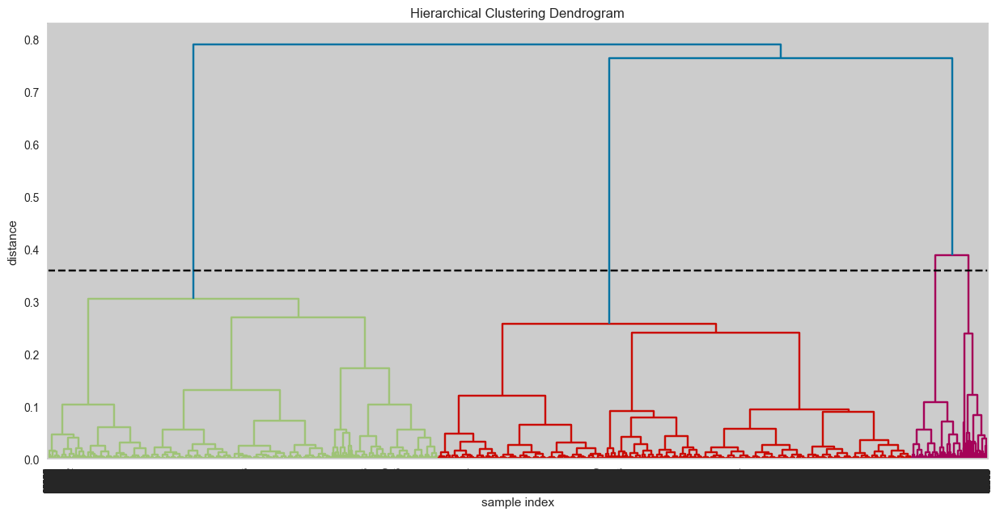

In [25]:
from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering

# plot the dendrogram
plt.figure(figsize=(15, 7))
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('sample index')
plt.ylabel('distance')
dendrogram(Z, leaf_rotation=90., leaf_font_size=8.)
plt.axhline(y=0.36, color='black', linestyle='--')
plt.show()

In [26]:
# cut the dendrogram at a distance of 59 and draw a horizontal line
from scipy.cluster.hierarchy import fcluster
max_d = 0.36
clusters = fcluster(Z, max_d, criterion='distance')

len(np.unique(clusters))

4

In [38]:
sample

,0,0,1,2,3,4,5,6,7,8,...,50,51,52,53,54,55,56,57,58,59
0,24b4663e9ed08d1cf20ab7767b3250a3,-0.094343,-0.058378,0.065506,0.171112,-0.014608,0.198499,0.300719,0.440546,-0.090842,...,-0.208658,-0.153152,-0.271609,-0.313652,-0.320309,0.200372,0.176706,0.312244,0.176398,0.256979
0,cfd02bea61d8e85869110ad85bfc9ef5,-0.094438,-0.058100,0.065047,0.170935,-0.015203,0.198684,0.300968,0.440765,-0.090337,...,-0.208717,-0.153115,-0.271826,-0.313690,-0.320393,0.200249,0.176651,0.312228,0.176518,0.256824
0,b93e705ecec4d97268693b068a047a5f,-0.094297,-0.058516,0.065732,0.171199,-0.014315,0.198408,0.300596,0.440437,-0.091091,...,-0.208766,-0.153084,-0.272006,-0.313722,-0.320462,0.200146,0.176604,0.312215,0.176617,0.256695
0,bbb274d156da2bab113ca334c3345ee5,-0.094345,-0.058374,0.065499,0.171110,-0.014617,0.198502,0.300722,0.440549,-0.090835,...,-0.208843,-0.153037,-0.272284,-0.313772,-0.320569,0.199988,0.176533,0.312195,0.176771,0.256496
0,814bfcdae2e4bb928da914fae6d5dfd8,-0.094526,-0.057843,0.064623,0.170771,-0.015753,0.198853,0.301196,0.440966,-0.089869,...,-0.208560,-0.153212,-0.271252,-0.313588,-0.320171,0.200574,0.176798,0.312269,0.176201,0.257235
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0,590a34e4c1d027bd20b9e3b5325efe09,-0.094166,-0.058908,0.066375,0.171443,-0.013482,0.198145,0.300244,0.440128,-0.091797,...,-0.208554,-0.153216,-0.271229,-0.313584,-0.320163,0.200587,0.176804,0.312270,0.176188,0.257251
0,2eb6e78eac104b4a8adcdce62be40a76,-0.094278,-0.058572,0.065824,0.171234,-0.014196,0.198370,0.300545,0.440393,-0.091192,...,-0.208542,-0.153223,-0.271188,-0.313577,-0.320147,0.200610,0.176815,0.312273,0.176166,0.257280
0,e91de0cd1805d4c23b74e2abc6005341,-0.094143,-0.058978,0.066488,0.171485,-0.013335,0.198099,0.300182,0.440074,-0.091921,...,-0.208695,-0.153128,-0.271745,-0.313676,-0.320362,0.200294,0.176671,0.312234,0.176473,0.256881
0,6b89c00d5f2da8b5d096d31e9a39a6c3,-0.094120,-0.059047,0.066602,0.171528,-0.013189,0.198052,0.300119,0.440019,-0.092045,...,-0.208636,-0.153165,-0.271531,-0.313638,-0.320279,0.200416,0.176726,0.312249,0.176355,0.257035


In [27]:
# plot the clusters obtained using Agglomerative Clustering in a 3D space
pca_3d_object, df_pca_3d = get_pca_3d(sample.iloc[:, 1:], clusters)
plot_pca_3d(df_pca_3d, title = "Hierarchical Clustering")
print("The variability is :", pca_3d_object.eigenvalues_summary)

The variability is :           eigenvalue % of variance % of variance (cumulative)
component                                                    
0             23.537        39.23%                     39.23%
1             19.987        33.31%                     72.54%
2             16.456        27.43%                     99.97%


In [28]:
pca_2d_object, df_pca_2d = get_pca_2d(sample.iloc[:, 1:], clusters)
plot_pca_2d(df_pca_2d, title = "PCA Space", opacity=1, width_line = 0.2)
print("The variability is :", pca_2d_object.eigenvalues_summary)

The variability is :           eigenvalue % of variance % of variance (cumulative)
component                                                    
0             23.537        39.23%                     39.23%
1             19.987        33.31%                     72.54%


In [29]:
from sklearn.metrics import silhouette_score
from sklearn.metrics import calinski_harabasz_score
from sklearn.metrics import davies_bouldin_score

"""
The Davies Bouldin index is defined as the average similarity measure of each cluster with its most similar cluster, where similarity is the ratio of within-cluster distances to between-cluster distances.
The minimum value of the DB Index is 0, whereas a smaller value (closer to 0) represents a better model that produces better clusters.
"""
print(f"Davies bouldin score: {davies_bouldin_score(sample.iloc[:, 1:], clusters)}")

"""
Calinski Harabaz Index -> Variance Ratio Criterion.
Calinski Harabaz Index is defined as the ratio of the sum of between-cluster dispersion and of within-cluster dispersion.
The higher the index the more separable the clusters.
"""
print(f"Calinski Score: {calinski_harabasz_score(sample.iloc[:, 1:], clusters)}")


"""
The silhouette score is a metric used to calculate the goodness of fit of a clustering algorithm, but can also be used as a method for determining an optimal value of k (see here for more).
Its value ranges from -1 to 1.
A value of 0 indicates clusters are overlapping and either the data or the value of k is incorrect.
1 is the ideal value and indicates that clusters are very dense and nicely separated.
"""
print(f"Silhouette Score: {silhouette_score(sample.iloc[:, 1:], clusters)}")

Davies bouldin score: 0.7936892867486383
Calinski Score: 36650.5447812393
Silhouette Score: 0.429964873851072
